In [1]:
import scanpy as sc
import gzip
from scipy.io import mmread
import pandas as pd
import anndata as ad
import numpy as np
import scanpy.external as sce
import glob

batches = ['GSE119926', 'GSE156053', 'GSM6043809_HDMB03_scramble', 'GSM6043811_MB3W1_scramble']
genes_of_interest = ['ALCAM','APP','BTLA','CCL17','CCL2','CCL3','CD160','CD200','CD24','CD244','CD274','CD276','CD47',
                     'CD48','CD80','CD86','CEACAM1','COLEC12','CSF1','CTLA4','CXCL12','CXCR4','EOMES','HAVCR2','IDO1',
                     'LAG3','MAF','NOD2','PDCD1','PVR','SYK','TGFB1','TGFB2','TIGIT','TNFRSF11B','TNFRSF14','VEGFA']

In [25]:
# load GSE119926
folder_path = "./GSE119926"

# Use glob to find files ending with .txt.gz
files_list = glob.glob(f'{folder_path}/*.txt.gz')

adatas_GSE119926 = []

for file in files_list:
    counts_df = pd.read_csv(file, index_col=0, compression='gzip', sep='\t')
    counts_df_transposed = counts_df.transpose()

    # create AnnData object
    adata_temp = ad.AnnData(X=counts_df_transposed)
    adata_temp.obs['batch'] = file.replace("./GSE119926/", "").split("_")[0]

    sc.pp.filter_cells(adata_temp, min_genes=2500)

    sc.pp.normalize_total(adata_temp, target_sum=1e4)
    sc.pp.log1p(adata_temp)

    adatas_GSE119926.append(adata_temp)

adata = ad.concat(adatas_GSE119926, axis=0, join='outer')
print(adata.obs['batch'])
np.nan_to_num(adata.X, copy=False)
adata.write_h5ad(batches[0]+'.h5ad')

normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
   

# load GSE 156053 HUMAN
# file paths
counts_file_path = "./GSE156053/GSE155446_human_raw_counts.csv.gz"
metadata_file_path = "./GSE156053/GSE155446_human_cell_metadata.csv.gz"

# load counts matrix and metadata
counts_df = pd.read_csv(counts_file_path, index_col=0, compression='gzip')
counts_df_transposed = counts_df.transpose()
metadata_df = pd.read_csv(metadata_file_path, index_col=0, compression='gzip')

# create AnnData object
adata = ad.AnnData(X=counts_df_transposed, obs=metadata_df[['coarse_cell_type', 'geo_sample_id']])
adata.obs.rename(columns={'geo_sample_id': 'batch'}, inplace=True)
print(adata)
print(adata.obs['batch'])

# do QC to individual sets
unique_batches = adata.obs['batch'].unique()

for batch_name in unique_batches:
    sc.pp.filter_cells(adata[adata.obs['batch'] == batch_name, :], min_genes=2500)
    
    sc.pp.normalize_total(adata[adata.obs['batch'] == batch_name, :], target_sum=1e4)
    sc.pp.log1p(adata[adata.obs['batch'] == batch_name, :])

adata.write_h5ad(batches[1]+'.h5ad')

AnnData object with n_obs × n_vars = 17782 × 36601
    obs: 'batch'


/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:220: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']


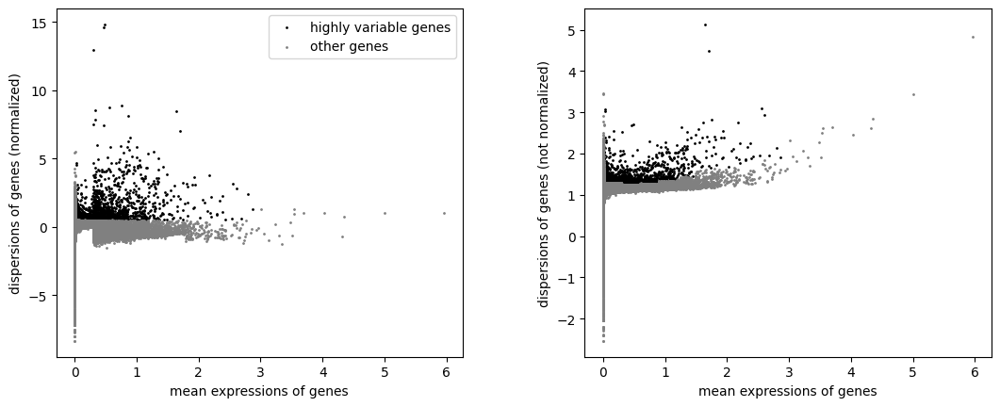

/home/lzhang36/.local/lib/python3.10/site-packages/anndata/_core/anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


AnnData object with n_obs × n_vars = 17767 × 2394
    obs: 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg'
AnnData object with n_obs × n_vars = 17767 × 36601
    obs: 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'


In [18]:
# load GSM6043809_HDMB03_scramble
# file paths
matrix_file_path = './GSE200791/GSM6043809_HDMB03_scramble_count_matrix.txt.gz'

counts_df = pd.read_csv(matrix_file_path, index_col=0, compression='gzip', sep='\t')
counts_df_transposed = counts_df.transpose()

# create AnnData object
adata = ad.AnnData(X=counts_df_transposed)
adata.obs['batch'] = batches[2]
print(adata)

adata.var['mt'] = adata.var_names.str.startswith('MT-')
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

adata = adata[adata.obs.pct_counts_mt < 5, :]

sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
# sc.pl.highly_variable_genes(adata)

adata.raw = adata
adata_plot = adata[:, adata.var.highly_variable]
sc.pp.regress_out(adata_plot, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(adata_plot, max_value=10)

print(adata_plot)
print(adata)
adata_plot.write_h5ad(batches[2]+'_plot.h5ad')
adata.write_h5ad(batches[2]+'.h5ad')

In [20]:
# load GSM6043811_MB3W1_scramble
# file paths
matrix_file_path = './GSE200791/GSM6043811_MB3W1_scramble_count_matrix.txt.gz'

counts_df = pd.read_csv(matrix_file_path, index_col=0, compression='gzip', sep='\t')
counts_df_transposed = counts_df.transpose()

# create AnnData object
adata = ad.AnnData(X=counts_df_transposed)
adata.obs['batch'] = batches[2]
print(adata)

adata.var['mt'] = adata.var_names.str.startswith('MT-')
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

adata = adata[adata.obs.pct_counts_mt < 5, :]

sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
# sc.pl.highly_variable_genes(adata)

adata.raw = adata
adata_plot = adata[:, adata.var.highly_variable]
sc.pp.regress_out(adata_plot, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(adata_plot, max_value=10)

print(adata_plot)
print(adata)
adata_plot.write_h5ad(batches[3]+'_plot.h5ad')
adata.write_h5ad(batches[3]+'.h5ad')

AnnData object with n_obs × n_vars = 11114 × 36601
    obs: 'batch'


/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
regressing out ['total_counts', 'pct_counts_mt']


/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:220: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']
/home/lzhang36/.local/lib/python3.10/site-packages/anndata/_core/anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


    finished (0:00:59)
AnnData object with n_obs × n_vars = 11102 × 6998
    obs: 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg'
AnnData object with n_obs × n_vars = 11102 × 36601
    obs: 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'


export NUM_THREADS=1 export OPENBLAS_NUM_THREADS=1 export OMP_NUM_THREADS=1

AnnData object with n_obs × n_vars = 8691 × 23686
    obs: 'batch', 'n_genes'
    uns: 'pca'
    obsm: 'X_pca', 'X_pca_harmony'
    varm: 'PCs'
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished (0:00:02)
computing UMAP
    finished (0:00:10)
running Leiden clustering
    finished (0:00:05)


/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


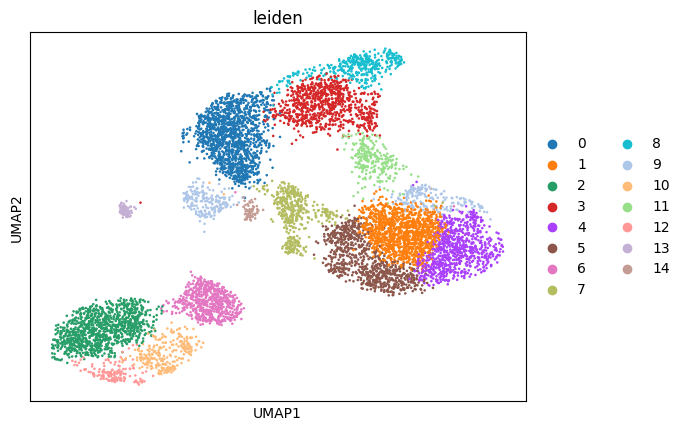

/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


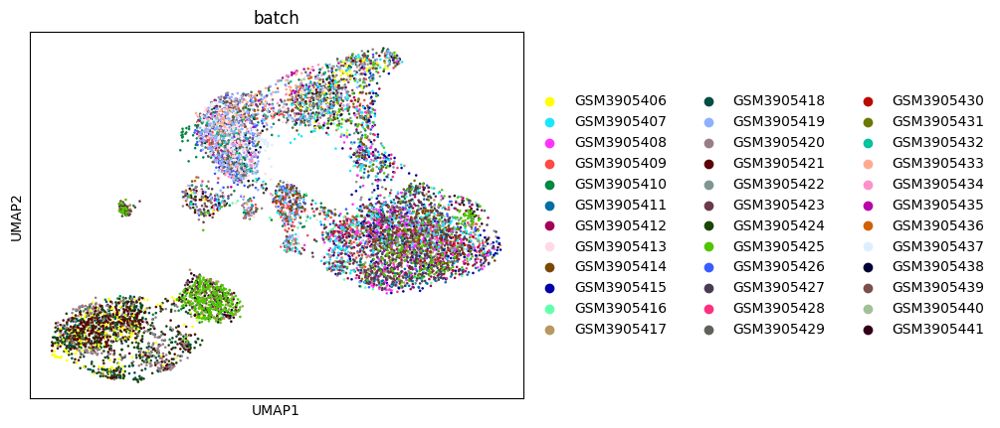

ranking genes


/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


    finished (0:00:15)
computing score 'score'


/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: Runt

    finished (0:00:00)


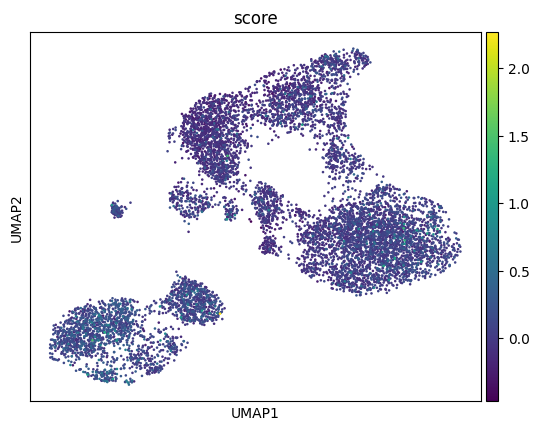

In [7]:
# GSE119926 umap
adata_GSE119926 = ad.read_h5ad('GSE119926_batched.h5ad')
print(adata_GSE119926)
adata_GSE119926.obsm['X_pca'] = adata_GSE119926.obsm['X_pca_harmony']
sc.pp.scale(adata_GSE119926)

sc.pp.neighbors(adata_GSE119926, n_neighbors=30)
sc.tl.umap(adata_GSE119926)
sc.tl.leiden(adata_GSE119926, resolution=1)
sc.pl.umap(adata_GSE119926, color=['leiden']) 
sc.pl.umap(adata_GSE119926, color=['batch']) 

# find significant genes
sc.settings.verbosity = 2  # reduce the verbosity

sc.tl.rank_genes_groups(adata_GSE119926, 'leiden', method='wilcoxon')
# sc.pl.rank_genes_groups(adata_GSE119926, n_genes=25, sharey=False)

sc.tl.score_genes(adata_GSE119926, gene_list=genes_of_interest)
sc.pl.umap(adata_GSE119926, color=['score'])

In [15]:
for cluster in adata_GSE119926.obs['leiden'].unique():
    df = sc.get.rank_genes_groups_df(adata_GSE119926, group=str(cluster))
    df.to_csv("GSE119926_gene_rank_"+str(cluster)+".csv", index=False)

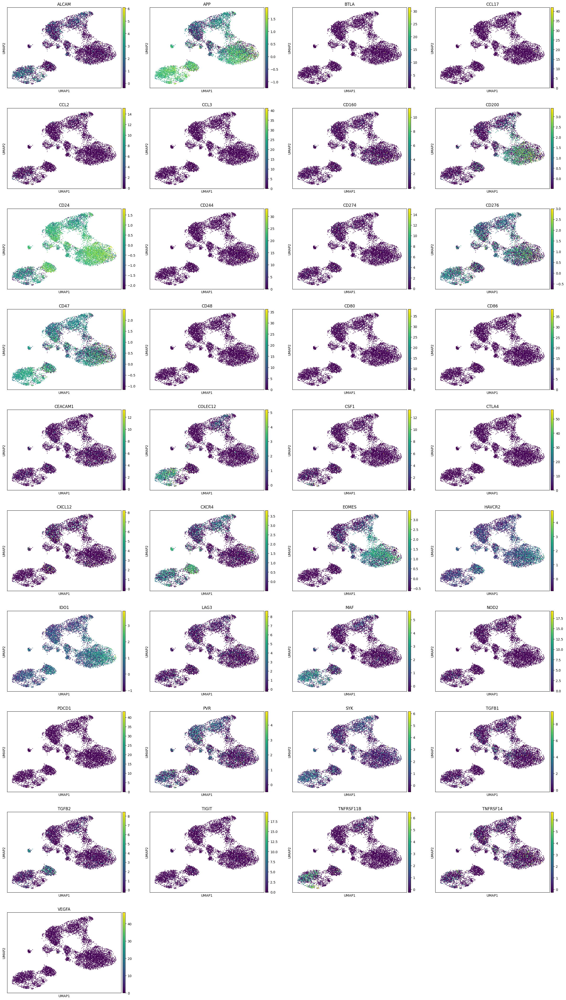

/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', '

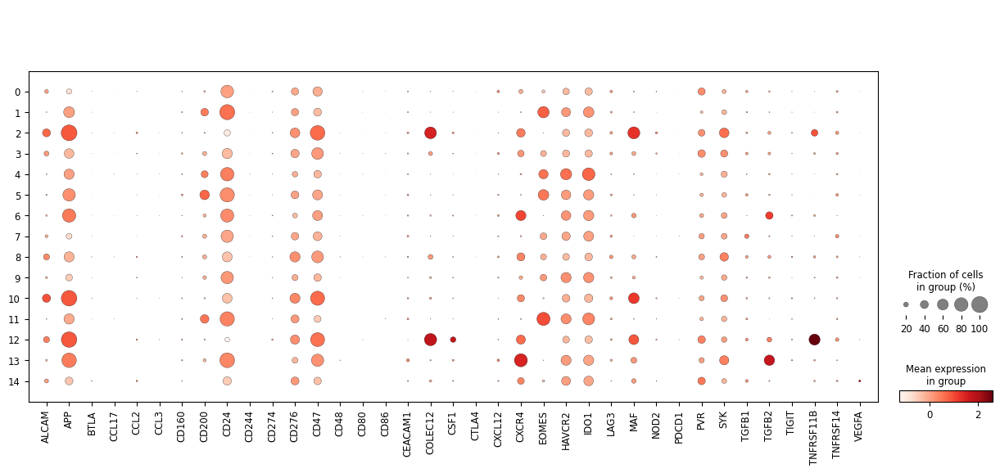

In [28]:
sc.pl.umap(adata_GSE119926, color=genes_of_interest)
sc.pl.dotplot(adata_GSE119926, var_names=genes_of_interest, groupby='leiden')

gene                    MIR1302-2HG  OR4F5  AL627309.1  AL627309.3  \
753_AAACGAAGTCTTGGTA            0.0    0.0         0.0         0.0   
753_AAACGCTTCCATGATG            0.0    0.0         0.0         0.0   
753_AAACGCTTCGAGTGGA            0.0    0.0         0.0         0.0   
753_AAAGAACCAAATGGTA            0.0    0.0         0.0         0.0   
753_AAAGAACTCATTCATC            0.0    0.0         0.0         0.0   
...                             ...    ...         ...         ...   
966-2_TTTGGAGGTATGAGAT          0.0    0.0         0.0         0.0   
966-2_TTTGGTTCATACAGCT          0.0    0.0         0.0         0.0   
966-2_TTTGGTTGTCCGTACG          0.0    0.0         0.0         0.0   
966-2_TTTGTTGTCGCTGACG          0.0    0.0         0.0         0.0   
966-2_TTTGTTGTCGTCGATA          0.0    0.0         0.0         0.0   

gene                    AL732372.1  AL669831.2  AL669831.5  FAM87B  LINC00115  \
753_AAACGAAGTCTTGGTA           0.0         0.0    0.000000     0.0        0.0 

/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


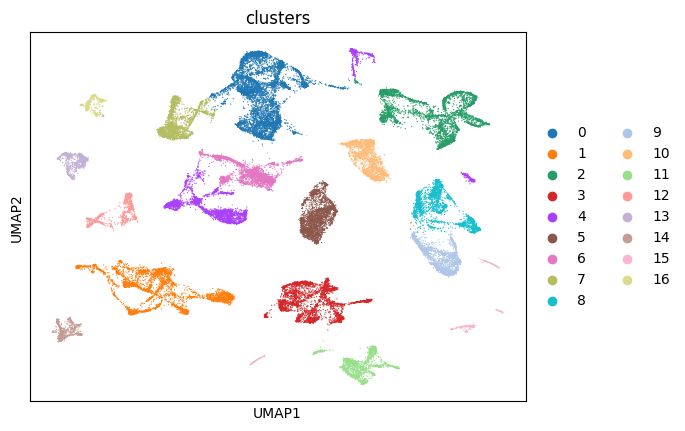

/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


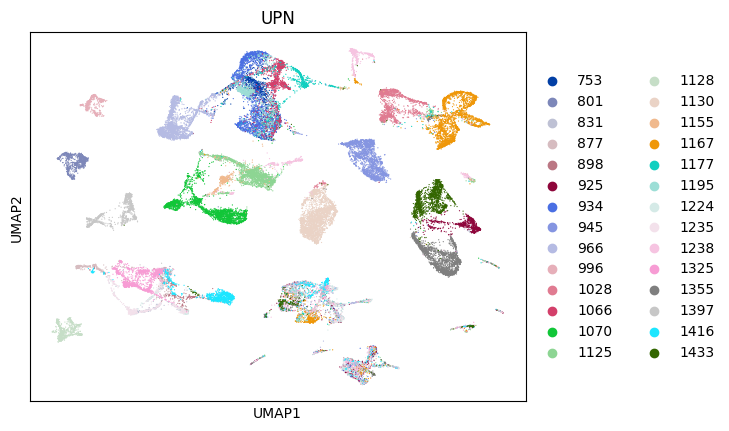

computing score 'score'
    finished (0:00:04)


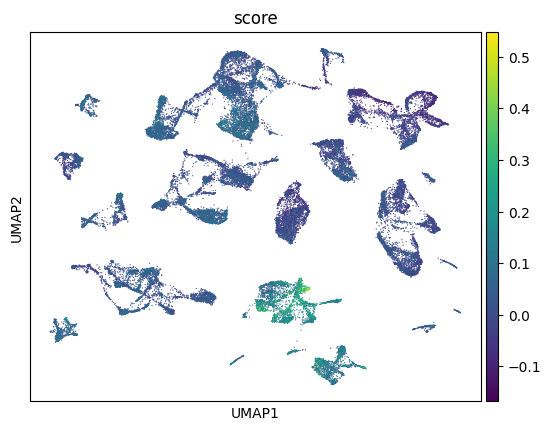

In [16]:
# GSE156053 preprocessed umap
exprMatrix_path = "./GSE156053/exprMatrix.tsv.gz.tsv"
umapCoords_path = "./GSE156053/umap.coords.tsv.gz.tsv"
meta_path = "./GSE156053/meta.tsv"

with gzip.open(exprMatrix_path, 'rt') as file:
    exprMatrix = pd.read_csv(file, sep='\t', index_col=0)
exprMatrix_transposed = exprMatrix.transpose()

with gzip.open(umapCoords_path, 'rt') as file:
    umapCoords = pd.read_csv(file, sep='\t', index_col=0, header=None)

meta = pd.read_csv(meta_path, sep='\t', index_col=0)

print(exprMatrix_transposed)
print(umapCoords)
print(meta)

adata_GSE156053pp = ad.AnnData(X=exprMatrix_transposed, obs=meta)
adata_GSE156053pp.obsm['X_umap'] = umapCoords.values
print(adata_GSE156053pp)

adata_GSE156053pp.obs['clusters'] = adata_GSE156053pp.obs['clusters'].astype('category')
adata_GSE156053pp.obs['UPN'] = adata_GSE156053pp.obs['UPN'].astype('category')
sc.pl.umap(adata_GSE156053pp, color=['clusters'])
sc.pl.umap(adata_GSE156053pp, color=['UPN'])

adata_GSE156053pp.write_h5ad('GSE156053.h5ad')

# find significant genes
sc.settings.verbosity = 2  # reduce the verbosity

# sc.tl.rank_genes_groups(adata_GSE156053pp, 'leiden', method='wilcoxon')
# sc.pl.rank_genes_groups(adata_GSE156053pp, n_genes=25, sharey=False)

sc.tl.score_genes(adata_GSE156053pp, gene_list=genes_of_interest)
sc.pl.umap(adata_GSE156053pp, color=['score'])

In [19]:
sc.tl.rank_genes_groups(adata_GSE156053pp, 'clusters', method='wilcoxon')

for cluster in adata_GSE156053pp.obs['clusters'].unique():
    df = sc.get.rank_genes_groups_df(adata_GSE156053pp, group=str(cluster))
    df.to_csv("GSE156053_gene_rank_"+str(cluster)+".csv", index=False)

ranking genes


/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


    finished (0:02:04)


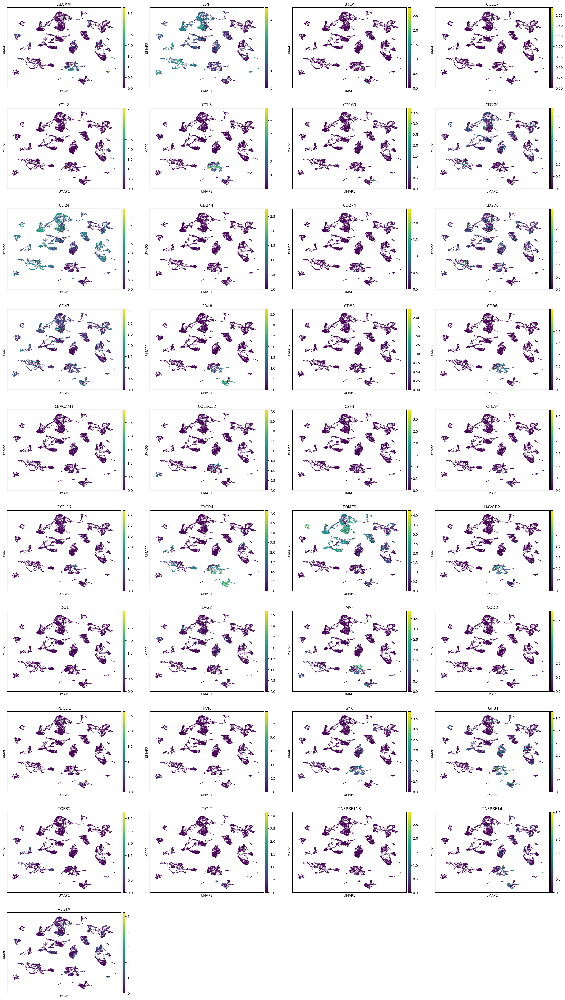

/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', '

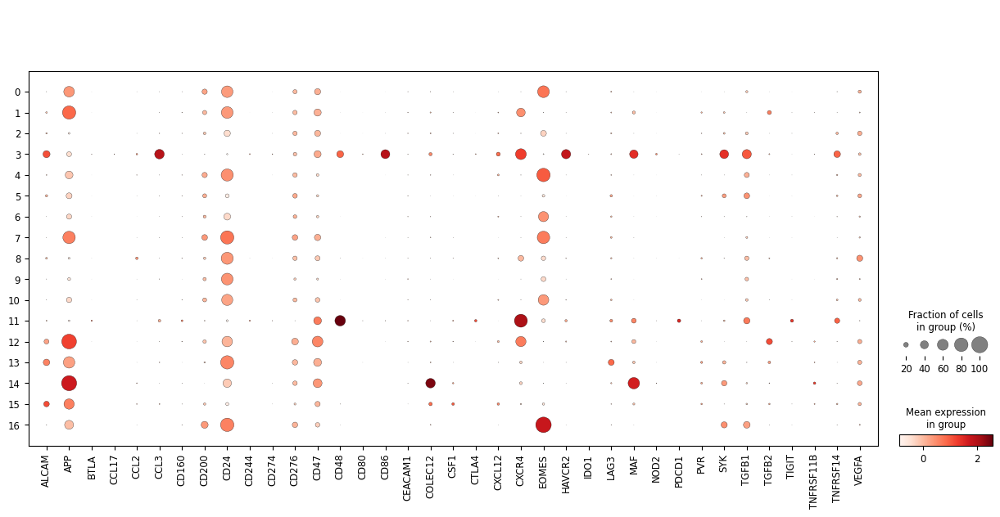

In [32]:
sc.pl.umap(adata_GSE156053pp, color=genes_of_interest)
adata_GSE156053_scaled = adata_GSE156053pp.copy()
sc.pp.scale(adata_GSE156053_scaled)
sc.pl.dotplot(adata_GSE156053_scaled, var_names=genes_of_interest, groupby='clusters')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 40
    finished (0:00:03)
computing UMAP
    finished (0:00:09)
running Leiden clustering
    finished (0:00:14)


/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


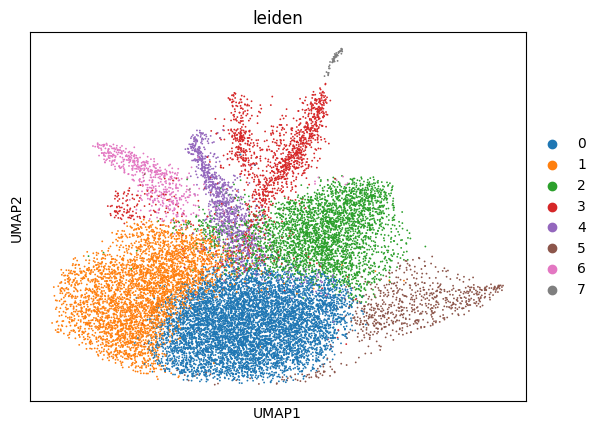

computing score 'score'
    finished (0:00:01)


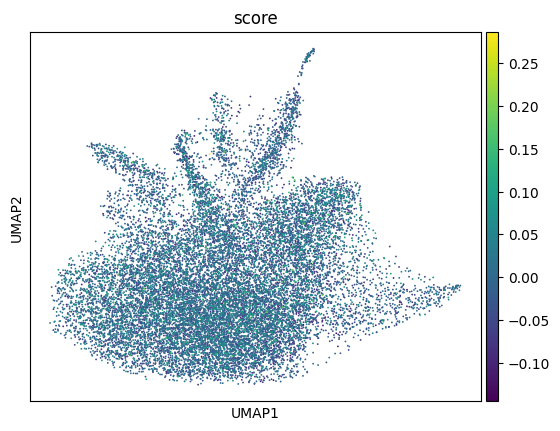

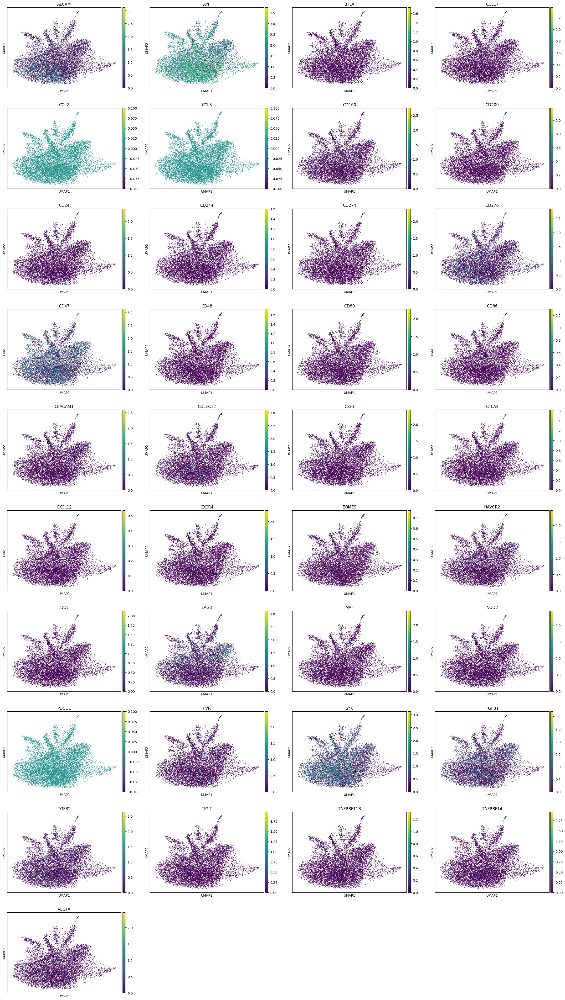

/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', '

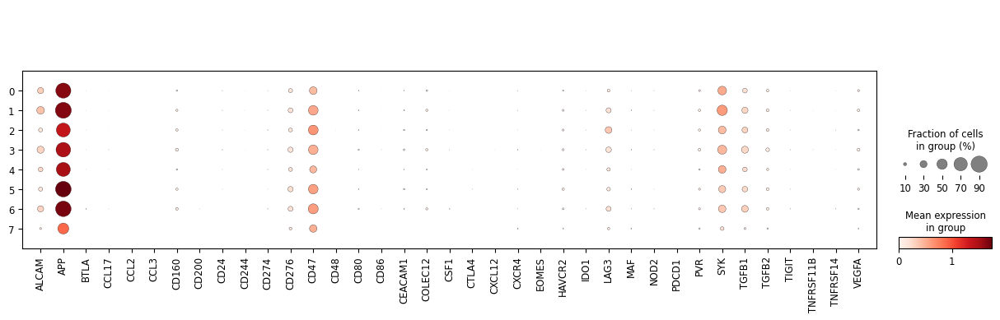

In [21]:
# GSM6043809_HDMB03_scramble umap
adata_GSM6043809 = ad.read_h5ad('GSM6043809_HDMB03_scramble.h5ad')
adata_GSM6043809_plot = ad.read_h5ad('GSM6043809_HDMB03_scramble_plot.h5ad')

sc.pp.pca(adata_GSM6043809_plot, svd_solver='arpack')
sc.pp.neighbors(adata_GSM6043809_plot, n_neighbors=30, n_pcs=40)
sc.tl.umap(adata_GSM6043809_plot)
sc.tl.leiden(adata_GSM6043809_plot, resolution=0.5)
sc.pl.umap(adata_GSM6043809_plot, color=['leiden']) 

# find significant genes
sc.settings.verbosity = 2  # reduce the verbosity

# sc.tl.rank_genes_groups(adata_GSM6043809, 'leiden', method='wilcoxon')
# sc.pl.rank_genes_groups(adata_GSM6043809, n_genes=25, sharey=False)

adata_GSM6043809.obs['leiden'] = adata_GSM6043809_plot.obs['leiden']
adata_GSM6043809.obsm['X_umap'] = adata_GSM6043809_plot.obsm['X_umap']

sc.tl.score_genes(adata_GSM6043809, gene_list=genes_of_interest)
sc.pl.umap(adata_GSM6043809, color=['score'])

sc.pl.umap(adata_GSM6043809, color=genes_of_interest)
adata_GSM6043809_scaled = adata_GSM6043809.copy()
sc.pp.scale(adata_GSM6043809_scaled)
sc.pl.dotplot(adata_GSM6043809_scaled, var_names=genes_of_interest, groupby='leiden')

In [22]:
sc.tl.rank_genes_groups(adata_GSM6043809, 'leiden', method='wilcoxon')

for cluster in adata_GSM6043809.obs['leiden'].unique():
    df = sc.get.rank_genes_groups_df(adata_GSM6043809, group=str(cluster))
    df.to_csv("GSM6043809_gene_rank_"+str(cluster)+".csv", index=False)

ranking genes


/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


    finished (0:00:31)


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:02)
computing neighbors
    using 'X_pca' with n_pcs = 40
    finished (0:00:02)
computing UMAP
    finished (0:00:05)
running Leiden clustering
    finished (0:00:04)


/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


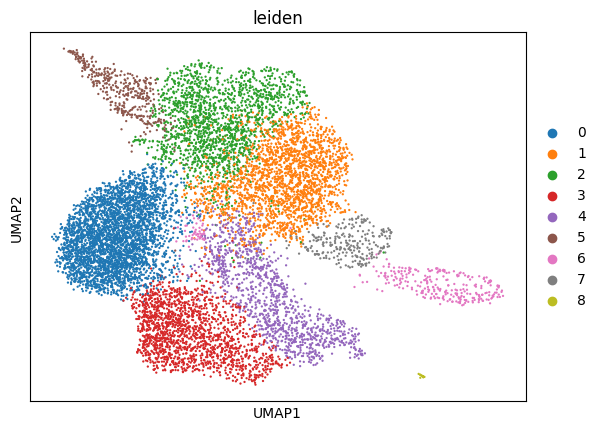

computing score 'score'
    finished (0:00:01)


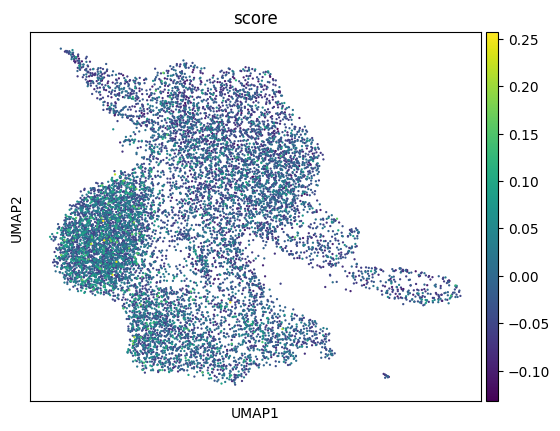

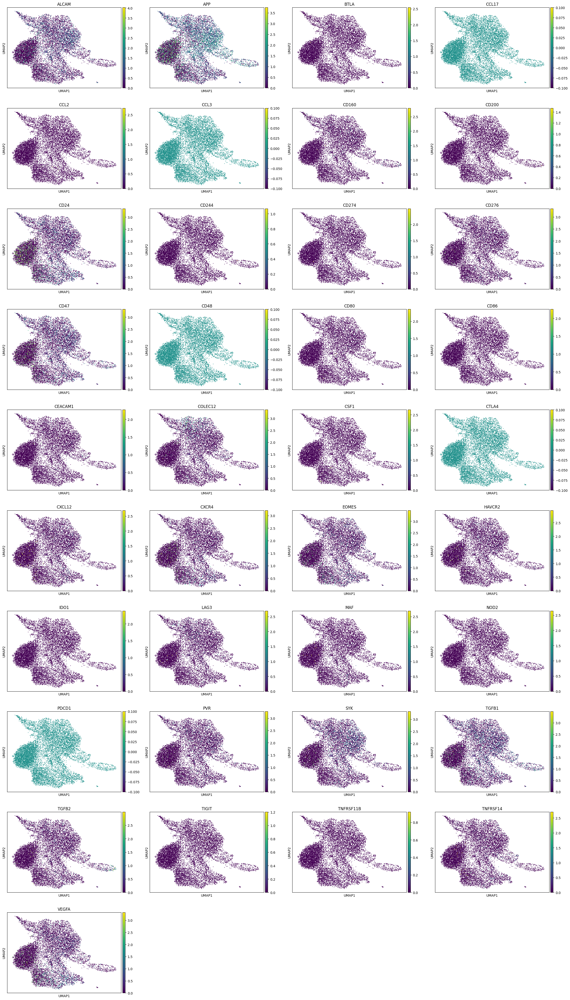

/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', '

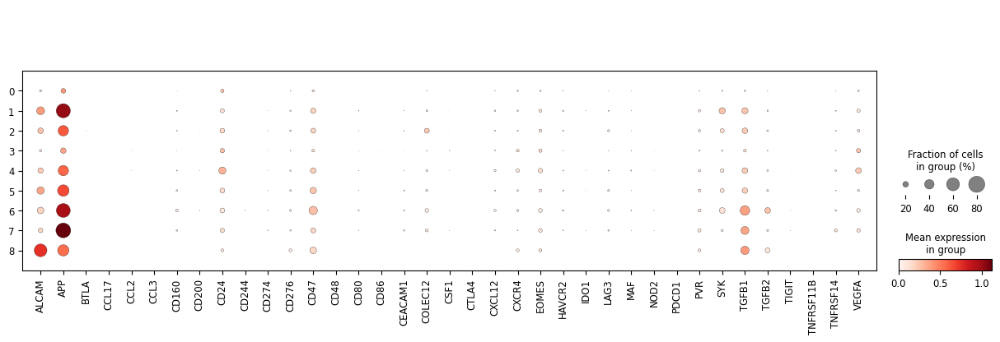

In [24]:
# GSM6043811_MB3W1_scramble umap
adata_GSM6043811 = ad.read_h5ad('GSM6043811_MB3W1_scramble.h5ad')
adata_GSM6043811_plot = ad.read_h5ad('GSM6043811_MB3W1_scramble_plot.h5ad')

sc.pp.pca(adata_GSM6043811_plot, svd_solver='arpack')
sc.pp.neighbors(adata_GSM6043811_plot, n_neighbors=30, n_pcs=40)
sc.tl.umap(adata_GSM6043811_plot)
sc.tl.leiden(adata_GSM6043811_plot, resolution=0.5)
sc.pl.umap(adata_GSM6043811_plot, color=['leiden']) 

# find significant genes
sc.settings.verbosity = 2  # reduce the verbosity

# sc.tl.rank_genes_groups(adata_GSM6043809, 'leiden', method='wilcoxon')
# sc.pl.rank_genes_groups(adata_GSM6043809, n_genes=25, sharey=False)

adata_GSM6043811.obs['leiden'] = adata_GSM6043811_plot.obs['leiden']
adata_GSM6043811.obsm['X_umap'] = adata_GSM6043811_plot.obsm['X_umap']

sc.tl.score_genes(adata_GSM6043811, gene_list=genes_of_interest)
sc.pl.umap(adata_GSM6043811, color=['score'])

sc.pl.umap(adata_GSM6043811, color=genes_of_interest)
adata_GSM6043811_scaled = adata_GSM6043811.copy()
sc.pp.scale(adata_GSM6043811_scaled)
sc.pl.dotplot(adata_GSM6043811_scaled, var_names=genes_of_interest, groupby='leiden')

In [25]:
sc.tl.rank_genes_groups(adata_GSM6043811, 'leiden', method='wilcoxon')

for cluster in adata_GSM6043811.obs['leiden'].unique():
    df = sc.get.rank_genes_groups_df(adata_GSM6043811, group=str(cluster))
    df.to_csv("GSM6043811_gene_rank_"+str(cluster)+".csv", index=False)

ranking genes


/mnt/scratch1/miniconda3/envs/singlecell012024/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


    finished (0:00:20)


computing score 'score'
    finished (0:00:00)


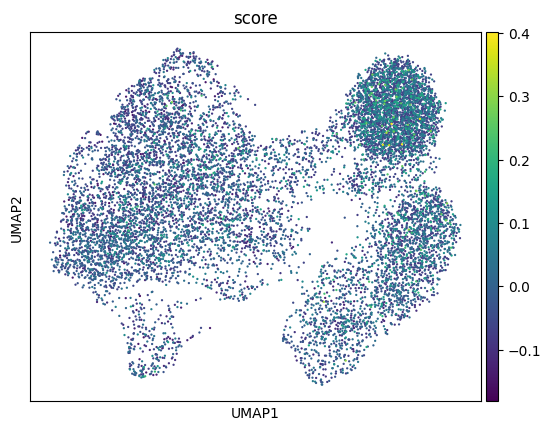

In [43]:
sc.tl.score_genes(adata_GSM6043811, gene_list=genes_of_interest)
sc.pl.umap(adata_GSM6043811, color=['score'])

In [ ]:
folder_path = './GSE156053/PhenoGenes/'
files_list = glob.glob(f'{folder_path}/*.csv')

array = []
for file in files_list:
    array.append(pd.read_csv(file, index_col=0))

array_top = []
for i in range(len(array)):
    array[i] = array[i].sort_values(by='logFC', ascending=False)
    array_top.append(array[i].head(n=10))
    # print(array[i])

group_genes_dict = {}

for df in array_top:
    group_name = df['group'].iloc[0]  # Assuming all rows in the DataFrame have the same group name
    gene_list = df.index.tolist()
    
    # Update the dictionary
    group_genes_dict[group_name] = gene_list

# Print or use the resulting dictionary
print(group_genes_dict)

# Replace 'MS4A1' with 'MS4A14' in all lists of genes in the dictionary
for group_name, gene_list in group_genes_dict.items():
    if 'MS4A1' in gene_list:
        index_to_replace = gene_list.index('MS4A1')
        gene_list[index_to_replace] = 'MS4A14'

# Print or use the updated dictionary
print(group_genes_dict)